#Simple Neural Networks - Image


Red neuronal para clasificación de imagenes.

A continuación llamamos los paquetes que vamos a utilizar:

In [31]:
# Importación de paquetes
import numpy as np
import matplotlib.pyplot as plt
import sklearn
import sklearn.datasets
import sklearn.linear_model

import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

%matplotlib inline

## Conjunto de datos

Primero, cargamos el conjunto de datos sobre el que se va a trabajar.

Carguemos los datos de las imagenes:

In [32]:
import urllib
urllib.request.urlretrieve(
    'https://raw.githubusercontent.com/sergiomora03/AdvancedTopicsAnalytics/main/notebooks/img/ImportImagenesURL.py',
    'ImportImagenes.py'
  )

('ImportImagenes.py', <http.client.HTTPMessage at 0x1dc88c2e090>)

In [33]:
from ImportImagenes import *
from sklearn.model_selection import train_test_split

In [34]:
X,Y = import_imagenes()

In [35]:
X

array([[0.58823529, 0.70980392, 0.75686275, ..., 0.36862745, 0.37254902,
        0.44313725],
       [0.5372549 , 0.67843137, 0.7372549 , ..., 0.31372549, 0.33333333,
        0.40784314],
       [0.40392157, 0.53333333, 0.65098039, ..., 0.27058824, 0.29411765,
        0.38039216],
       ...,
       [0.20784314, 0.41176471, 0.2       , ..., 0.69411765, 0.74509804,
        0.74901961],
       [0.20392157, 0.42352941, 0.20784314, ..., 0.68627451, 0.69411765,
        0.70196078],
       [0.13333333, 0.31764706, 0.16470588, ..., 0.49803922, 0.61960784,
        0.61568627]])

In [36]:
 X.shape[0]

14700

In [37]:
X,Y = import_imagenes()

CE_x, CV_x, CE_y, CV_y = train_test_split(X.T, Y.T, test_size = 0.3, random_state = 100)

CE_x = CE_x.T
CV_x = CV_x.T
CE_y = CE_y.T
CV_y = CV_y.T

n=CE_y.shape[1]
m=CV_y.shape[1]

print(CE_x.shape, CV_x.shape, CE_y.shape, CV_y.shape, n, m)

(14700, 175) (14700, 75) (1, 175) (1, 75) 175 75


## Definiendo la estructura de la red neuronal

In [38]:
import tensorflow as tf

In [39]:
alpha=0.1

n_x = X.shape[0]      # tamaño de la capa de entrada
num_neuronas = 3    # número de neuronas en la capa escondida
n_y = Y.shape[0]      # tamaño de la acapa de salida

capa_o=tf.keras.layers.Dense(units=num_neuronas,input_shape=[n_x], activation = 'sigmoid')  #2 neuronas de la capa oculta (Units), 2 neuronas de la capa de entrada (input_shape)
capa_s=tf.keras.layers.Dense(units=n_y,activation = 'sigmoid')                   #1 neurona de la capa de salida (Units)

# Modelo secuencial de red neuronal
red_neu=tf.keras.Sequential([capa_o, capa_s]) #definición de las capas que conforman la red neuronal

red_neu.summary()


c:\Users\Acer\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_2 (Dense)                 │ (None, 3)              │        44,103 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │             4 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 44,107 (172.29 KB)

 Trainable params: 44,107 (172.29 KB)

 Non-trainable params: 0 (0.00 B)

In [13]:
red_neu.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(alpha), metrics=['binary_accuracy'])

In [14]:
# Entrenar el modelo
datos=red_neu.fit(CE_x.T, CE_y.T, epochs=1000,verbose=False)

In [15]:
#Evaluación del modelo (Revisión del accuracy obtenido)
scores = red_neu.evaluate(CE_x.T, CE_y.T)
print("\n%s: %.2f%%" % (red_neu.metrics_names[1], scores[1]*100))

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - binary_accuracy: 0.6282 - loss: 0.6567  

compile_metrics: 58.86%


In [16]:
#Evaluación del modelo (Revisión del accuracy obtenido)
scores = red_neu.evaluate(CV_x.T, CV_y.T)
print("\n%s: %.2f%%" % (red_neu.metrics_names[1], scores[1]*100))

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - binary_accuracy: 0.6070 - loss: 0.6707 

compile_metrics: 57.33%


Usamos Optuna para aplicar una optimización automática de hiperparámetros y así mejorar el rendimiento de la red. Optuna permite definir una función objetivo, y luego realiza búsquedas eficientes en el espacio de hiperparámetros para encontrar la mejor configuración posible.

In [48]:
import optuna
#import keras
from keras.models import Sequential
from keras.layers import Dense, Conv2D, Flatten
from keras.optimizers import RMSprop

#función objetivo a maximizar
def objective(trial):
    model = Sequential()

    # Valores de hiperparámetros sugeridos
    units = trial.suggest_int('units', 32, 512)
    activation = trial.suggest_categorical('activation', ['relu', 'tanh', 'sigmoid'])
    model.add(Dense(units=units, activation=activation, input_shape=(X.shape[0],)))

    model.add(Dense(1, activation='sigmoid'))

    # Aprendizaje sugerido
    lr = trial.suggest_loguniform('lr', 1e-5, 1e-1) #learning rate
    optimizer = RMSprop(learning_rate=lr)
    model.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy'])

    # Entrenar el modelo
    model.fit(CE_x.T, CE_y.T, epochs=5, batch_size=128, verbose=0, validation_data=(CV_x.T, CV_y.T))

    # Evaluar el modelo en el conjunto de prueba
    score = model.evaluate(CV_x.T, CV_y.T, verbose=0)
    accuracy = score[1]
    return accuracy

In [49]:
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)

print("Best trial:")
trial = study.best_trial
print("  Value: {}".format(trial.value))
print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

[I 2024-08-28 15:56:38,400] A new study created in memory with name: no-name-d8a1f271-17d7-4718-86c8-e46a6ad71e87
[I 2024-08-28 15:56:40,685] Trial 0 finished with value: 0.4266666769981384 and parameters: {'units': 321, 'activation': 'tanh', 'lr': 0.024321481340869745}. Best is trial 0 with value: 0.4266666769981384.
[I 2024-08-28 15:56:42,257] Trial 1 finished with value: 0.4266666769981384 and parameters: {'units': 183, 'activation': 'sigmoid', 'lr': 0.04693874085699417}. Best is trial 0 with value: 0.4266666769981384.
[I 2024-08-28 15:56:44,103] Trial 2 finished with value: 0.4533333480358124 and parameters: {'units': 295, 'activation': 'relu', 'lr': 0.0002200905503709815}. Best is trial 2 with value: 0.4533333480358124.
[I 2024-08-28 15:56:45,963] Trial 3 finished with value: 0.5733333230018616 and parameters: {'units': 354, 'activation': 'sigmoid', 'lr': 3.322846650268148e-05}. Best is trial 3 with value: 0.5733333230018616.
[I 2024-08-28 15:56:47,596] Trial 4 finished with value

Best trial:
  Value: 0.8266666531562805
  Params: 
    units: 419
    activation: sigmoid
    lr: 5.365528794292855e-05


In [53]:
best_params = study.best_params

#Creamos la red con los mejores parámetros encontrados con optuna
red_neu = Sequential()
red_neu.add(Dense(units=best_params['units'], activation=best_params['activation'], input_shape=(X.shape[0],)))
red_neu.add(Dense(1, activation='sigmoid'))
optimizer = RMSprop(learning_rate=best_params['lr'])

# Compilar el modelo
red_neu.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy'])

# Entrenar el modelo con los datos
datos = red_neu.fit(CE_x.T, CE_y.T, validation_data=(CV_x.T, CV_y.T), epochs=50, batch_size=32)

Epoch 1/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 110ms/step - accuracy: 0.4435 - loss: 1.5175 - val_accuracy: 0.5733 - val_loss: 1.0030
Epoch 2/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.6716 - loss: 0.6985 - val_accuracy: 0.7467 - val_loss: 0.6038
Epoch 3/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.6444 - loss: 0.6344 - val_accuracy: 0.6933 - val_loss: 0.5790
Epoch 4/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - accuracy: 0.6774 - loss: 0.6274 - val_accuracy: 0.7867 - val_loss: 0.5496
Epoch 5/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - accuracy: 0.5795 - loss: 0.6651 - val_accuracy: 0.7467 - val_loss: 0.5414
Epoch 6/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - accuracy: 0.7168 - loss: 0.5495 - val_accuracy: 0.6800 - val_loss: 0.5954
Epoch 7/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.7122 - loss: 0.5457 - val_accuracy: 0.5733 - val_loss: 0.6872
Epoch 8/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.6741 - loss: 0.5881 - val_accuracy: 0.7467 - val_loss: 0.5122

In [54]:
#Evaluación del modelo (Revisión del accuracy obtenido)
scores = red_neu.evaluate(CE_x.T, CE_y.T)
print("\n%s: %.2f%%" % (red_neu.metrics_names[1], scores[1]*100))

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7821 - loss: 0.4264 

compile_metrics: 80.00%


In [ ]:
#Evaluación del modelo (Revisión del accuracy obtenido)
scores = red_neu.evaluate(CV_x.T, CV_y.T)
print("\n%s: %.2f%%" % (red_neu.metrics_names[1], scores[1]*100))

Prueba _cualitativa_ del modelo

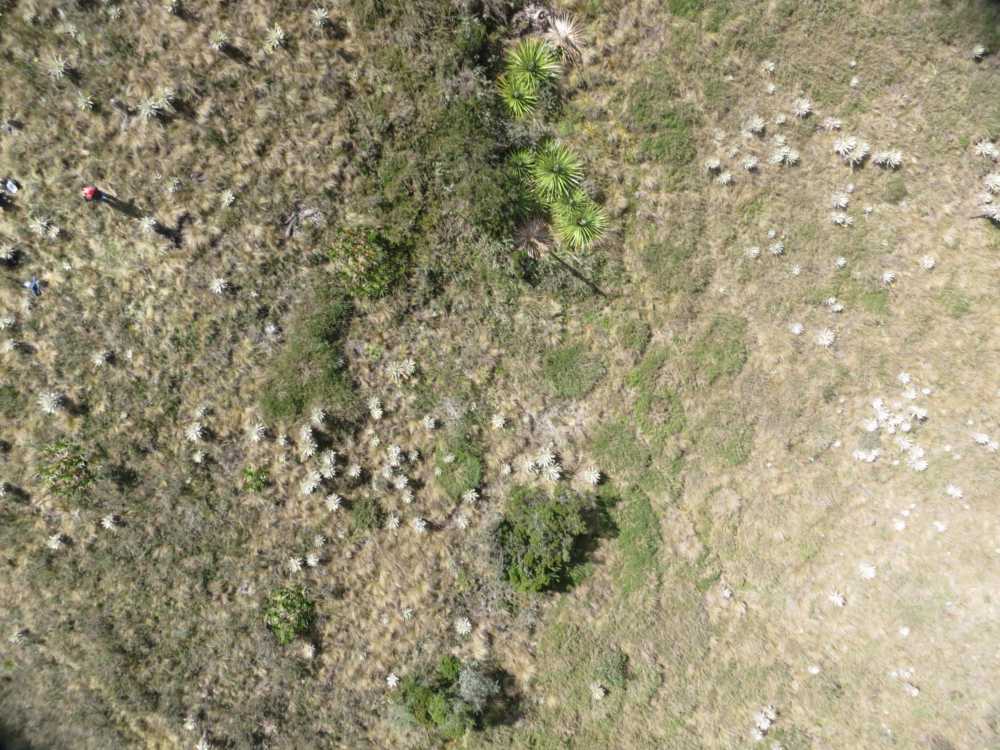

In [17]:
from tensorflow.keras.utils import load_img # import load_img from the correct module

urllib.request.urlretrieve('https://github.com/sergiomora03/AdvancedTopicsAnalytics/blob/main/notebooks/img/IMG_3451.JPG?raw=true', 'IMG_3451.JPG')
img = load_img('IMG_3451.JPG')
img

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


C:\Users\Acer\AppData\Local\Temp\ipykernel_5652\3519125545.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  pred_P = int(red_neu.predict(vec.T) > 0.5)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━

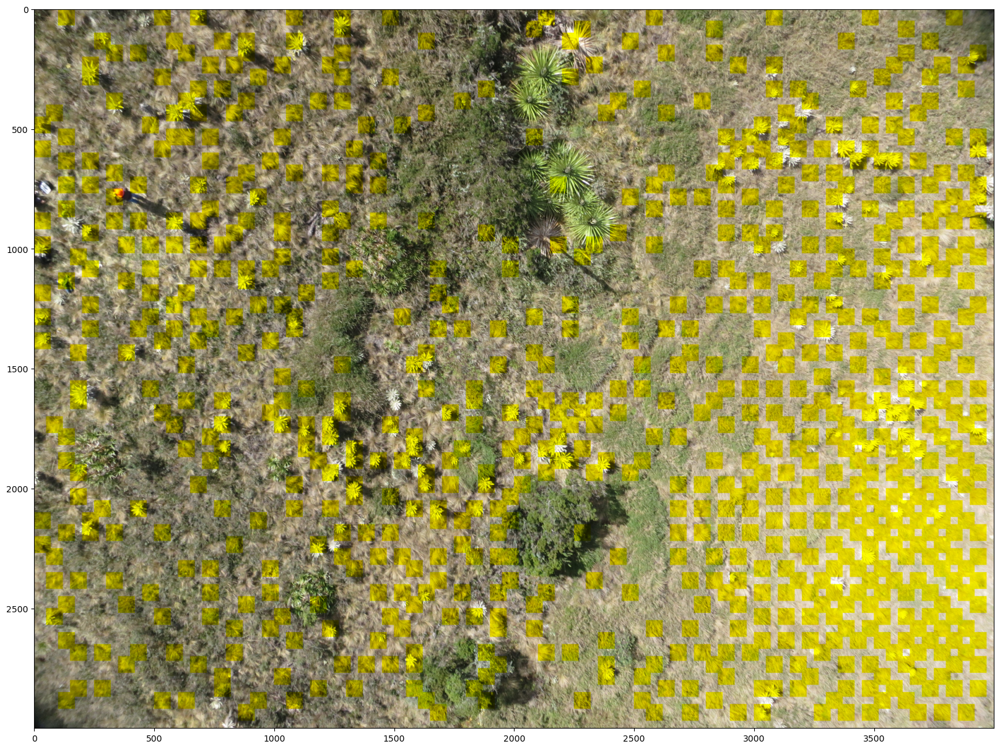

In [55]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]
        subi2=np.ndarray.flatten(subi).T/255.
        ns=subi2.shape[0]
        vec=subi2
        vec.shape=(ns,1)

        pred_P = int(red_neu.predict(vec.T) > 0.5)
        #pred_P= red_neu.predict(vec.T)
        #pred_P=pred(param, vec)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50

plt.figure(figsize = (20,20))
plt.imshow(x2)